In [ ]:
!pip install ultralytics
!pip install supervision huggingface_hub pillow
!pip install mediapipe gradio

ขั้นตอนหลักของการทำงาน

เตรียมสภาพแวดล้อม → ติดตั้งและนำเข้าไลบรารีที่จำเป็น

โหลดโมเดล YOLOv8 → ดาวน์โหลดโมเดลสำหรับตรวจจับใบหน้าจาก Hugging Face

สร้างฟังก์ชันสำหรับเบลอใบหน้า → รองรับ Gaussian Blur, Pixelation และ Emoji

สร้างฟังก์ชันตรวจจับใบหน้า → แสดงภาพพรีวิวที่มีกรอบรอบใบหน้า และเพิ่มตัวเลือกในการเลือกลำดับใบหน้า

สร้างฟังก์ชันสำหรับเบลอใบหน้าที่ไม่ได้เลือก → เบลอเฉพาะใบหน้าที่ไม่ได้ถูกเลือกไว้

ออกแบบ UI ด้วย Gradio → สร้างอินเตอร์เฟซสำหรับให้ผู้ใช้ควบคุมการเบลอ

In [ ]:
import cv2 # ใช้ประมวลผลภาพ
import numpy as np # ใช้จัดการ array ของภาพ
import gradio as gr # ใช้สร้าง UI
from huggingface_hub import hf_hub_download # ใช้ดาวน์โหลดโมเดลจาก Hugging Face
from ultralytics import YOLO # ใช้โหลดโมเดล YOLOv8
from supervision import Detections # ใช้จัดการข้อมูลการตรวจจับ
from PIL import Image, ImageDraw # ใช้จัดการรูปภาพ

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
model_path = hf_hub_download(repo_id="arnabdhar/YOLOv8-Face-Detection", filename="model.pt")
model = YOLO(model_path)

The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.


model.pt:   0%|          | 0.00/6.25M [00:00<?, ?B/s]

In [ ]:
# ฟังก์ชันสำหรับเบลอใบหน้า
def blur_face(img, x1, y1, x2, y2, method="gaussian"):
    face = img[y1:y2, x1:x2] # ตัดภาพเฉพาะส่วนที่เป็นใบหน้า

    if method == "gaussian":
        face = cv2.GaussianBlur(face, (85, 85), 30) # ใช้ Gaussian Blur เบลอใบหน้า
    elif method == "pixelation":
        h, w = face.shape[:2]
        temp = cv2.resize(face, (10, 10), interpolation=cv2.INTER_LINEAR)  # ลดขนาดให้เหลือ 10x10
        face = cv2.resize(temp, (w, h), interpolation=cv2.INTER_NEAREST) # ขยายกลับมาให้เป็น pixelation
    elif method == "emoji":
        mask = Image.open("emoji.png").resize((x2 - x1, y2 - y1)) # โหลดและปรับขนาดอิโมจิ
        img_pil = Image.fromarray(img)
        img_pil.paste(mask, (x1, y1), mask) # วาง png บนภาพ
        return np.array(img_pil)

    img[y1:y2, x1:x2] = face # แทนที่ใบหน้าด้วยภาพที่เบลอแล้ว
    return img

In [ ]:
# ฟังก์ชันตรวจจับใบหน้าและอัปเดตตัวเลือกใบหน้า
def interactive_blur(image, blur_type):
    img = np.array(image) # แปลงภาพให้เป็น numpy array
    results = model(img) # ใช้ YOLO ตรวจจับใบหน้า
    detections = Detections.from_ultralytics(results[0]) # ดึงค่าที่ได้จาก YOLO
    faces = detections.xyxy.astype(int) # พิกัดใบหน้า (x1, y1, x2, y2)

    img_pil = Image.fromarray(img)
    draw = ImageDraw.Draw(img_pil)
    face_list = [] # เก็บหมายเลขใบหน้า(แบบIndex)
    face_thumbnails = [] # เก็บตัวอย่างใบหน้าที่ตรวจพบ

    for i, (x1, y1, x2, y2) in enumerate(faces):
        draw.rectangle([x1, y1, x2, y2], outline="red", width=3) # วาดกรอบรอบใบหน้า
        draw.text((x1, y1 - 10), str(i), fill="red") # ใส่หมายเลขบนภาพ

        face_list.append(str(i)) # เพิ่มหมายเลขใบหน้าลงในตัวเลือก

        face_crop = img[y1:y2, x1:x2]
        face_crop = cv2.resize(face_crop, (50, 50)) # ย่อขนาดภาพใบหน้า
        face_thumbnails.append(Image.fromarray(face_crop)) # แปลงเป็น PIL Image

    return img_pil, gr.update(choices=face_list, value=[]), face_thumbnails # คืนค่าภาพตัวอย่าง, อัปเดตรายชื่อใบหน้า

In [ ]:
# ฟังก์ชันประมวลผลการเบลอใบหน้า
def process_image(image, blur_type, selected_faces):
    img = np.array(image)
    results = model(img) # ตรวจจับใบหน้าอีกครั้ง
    detections = Detections.from_ultralytics(results[0])
    faces = detections.xyxy.astype(int)

    for idx, (x1, y1, x2, y2) in enumerate(faces):
        if str(idx) not in selected_faces: # เบลอเฉพาะใบหน้าที่ไม่ได้ถูกเลือก

            img = blur_face(img, x1, y1, x2, y2, method=blur_type)

    return Image.fromarray(img) # คืนค่าภาพที่เบลอแล้ว

In [ ]:
with gr.Blocks() as demo:
    gr.Markdown("# 📸 Face Blur with YOLOv8 & Gradio") # หัวข้อ UI

    image_input = gr.Image(type="pil", label="อัปโหลดภาพ")
    blur_selector = gr.Radio(["gaussian", "pixelation", "emoji"], label="เลือกประเภทการเบลอ", value="gaussian")

    with gr.Row():
        preview = gr.Image(type="pil", label="ตัวอย่างภาพที่ตรวจพบ")

    with gr.Row():
        face_selector = gr.CheckboxGroup([], label="เลือกใบหน้าที่ไม่ต้องเบลอ", interactive=True)
        face_gallery = gr.Gallery(label="ตัวอย่างใบหน้า", height=100, columns=5)

    process_btn = gr.Button("🔄 เบลอภาพ")
    final_output = gr.Image(type="pil", label="ภาพที่เบลอแล้ว")

    # เมื่ออัปโหลดภาพ > ตรวจจับใบหน้า & อัปเดตตัวเลือกใบหน้า
    image_input.change(
        interactive_blur, inputs=[image_input, blur_selector],
        outputs=[preview, face_selector, face_gallery]
    )

    # เมื่อกดปุ่ม > ประมวลผลเบลอหน้า
    process_btn.click(
        process_image, inputs=[image_input, blur_selector, face_selector],
        outputs=final_output
    )
# เรียกใช้งาน Gradio
demo.launch()

Running Gradio in a Colab notebook requires sharing enabled. Automatically setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://3f339be68ccbb635d9.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


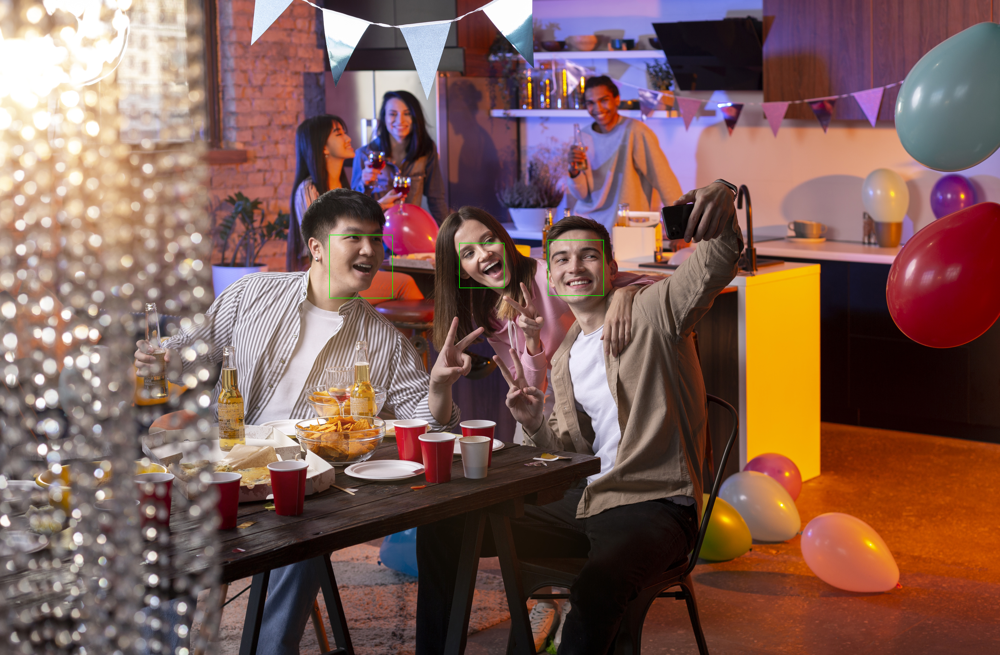

In [ ]:
import cv2
import mediapipe as mp
from google.colab.patches import cv2_imshow  # ใช้แสดงภาพใน Colab

# โหลดโมเดล Face Detection
mp_face_detection = mp.solutions.face_detection

# อ่านภาพ
image_path = "people1.jpg"
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# ใช้ Face Detection
with mp_face_detection.FaceDetection(model_selection=1, min_detection_confidence=0.3) as face_detection:
    results = face_detection.process(image_rgb)

    if results.detections:
        for detection in results.detections:
            bboxC = detection.location_data.relative_bounding_box
            ih, iw, _ = image.shape
            x, y, w, h = int(bboxC.xmin * iw), int(bboxC.ymin * ih), int(bboxC.width * iw), int(bboxC.height * ih)
            cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

# แสดงภาพใน Colab
cv2_imshow(image)



0: 448x640 6 FACEs, 36.3ms
Speed: 11.3ms preprocess, 36.3ms inference, 349.2ms postprocess per image at shape (1, 3, 448, 640)


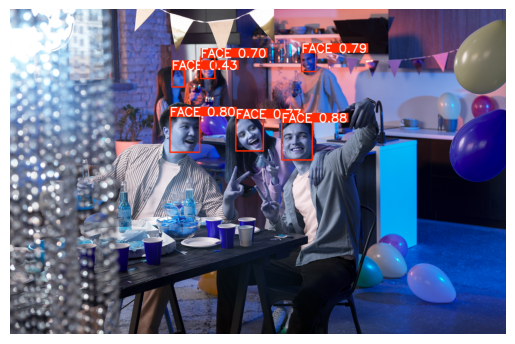

In [ ]:
import matplotlib.pyplot as plt
from huggingface_hub import hf_hub_download
from ultralytics import YOLO
from PIL import Image

model_path = hf_hub_download(repo_id="arnabdhar/YOLOv8-Face-Detection", filename="model.pt")
model = YOLO(model_path)

image_path = "people1.jpg"
image = Image.open(image_path)

output = model(image)

# แปลงผลลัพธ์เป็น Detections object
results = Detections.from_ultralytics(output[0])

plt.imshow(output[0].plot())
plt.axis("off")
plt.show()